In [1]:
%reset

Once deleted, variables cannot be recovered. Proceed (y/[n])?  y


In [6]:

import pandas as pd 
import numpy as np 
import os 
import glob
import plotly.express as px
import re
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import bioread
from scipy.signal import resample

import pytz

from datetime import datetime
from pathlib import Path


In [7]:
from smarwatch_modules.smartwatch_processing_module import *


In [8]:
# Temporarily disable printing.
import builtins
builtins.print = lambda *args, **kwargs: None
import warnings
warnings.filterwarnings('ignore')

In [9]:
root_folder_str = "/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/"
root_data_set= Path("/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/")

def run_main(root_folder_str,root_data_set):
    participant_folders = [folder.name for folder in root_data_set.iterdir() if folder.is_dir() and folder.name.startswith('P')]
    print(participant_folders)
    sorted_participants = sorted(participant_folders, key=lambda x: int(x[1:]))
    print("sorted_participants: ",sorted_participants)
    for participant_folder in sorted_participants:
        # if participant_folder !="P4":
        print("PID==  ",participant_folder)
        p_folder = root_folder_str + participant_folder +"/SMARTWATCH"
        dated_folders = [name for name in os.listdir(p_folder) if os.path.isdir(os.path.join(p_folder, name))]
        #print("dated_folders: ",dated_folders[0])
        smart_watch_base_folder = p_folder +"/"+ dated_folders[0]
       # print("smart_watch_base_folder: ",smart_watch_base_folder)
        file_type = 'csv'  # Change to 'xlsx', 'json', etc., as needed.
        file_pattern = os.path.join(smart_watch_base_folder, f'*.{file_type}')
        csv_files = glob.glob(file_pattern)
        print(csv_files)
        hr_df_pid  = process_heart_rate(csv_files)
        # Convert the column to datetime
        hr_df_pid["Timestamp"] = pd.to_datetime(hr_df_pid["Timestamp"], errors='coerce')

        # Sort by timestamp to ensure order
        hr_df_pid_sort = hr_df_pid.sort_values(by="Timestamp")
    
        print(hr_df_pid.head())
        print("participant_folder:",participant_folder)
        fig = participant_based_fig(hr_df_pid,participant_folder)
        fig.show()
        fig_raw_hr = plot_hr_raw_data(hr_df_pid_sort,participant_folder)
        fig_raw_hr.show()
    

b'Skipping line 239: expected 3 fields, saw 5\nSkipping line 4142: expected 3 fields, saw 4\nSkipping line 5342: expected 3 fields, saw 4\nSkipping line 5580: expected 3 fields, saw 4\nSkipping line 6242: expected 3 fields, saw 4\n'
b'Skipping line 1065: expected 3 fields, saw 5\nSkipping line 1965: expected 3 fields, saw 5\nSkipping line 2428: expected 3 fields, saw 5\nSkipping line 2591: expected 3 fields, saw 5\nSkipping line 3765: expected 3 fields, saw 5\nSkipping line 4665: expected 3 fields, saw 5\n'
b'Skipping line 187: expected 3 fields, saw 4\n'
b'Skipping line 1730: expected 3 fields, saw 5\n'
b'Skipping line 1142: expected 3 fields, saw 5\n'
b'Skipping line 162: expected 3 fields, saw 4\nSkipping line 1362: expected 3 fields, saw 5\nSkipping line 4062: expected 3 fields, saw 5\nSkipping line 4662: expected 3 fields, saw 5\nSkipping line 5262: expected 3 fields, saw 5\nSkipping line 5422: expected 3 fields, saw 5\n'
b'Skipping line 1743: expected 3 fields, saw 5\nSkipping li

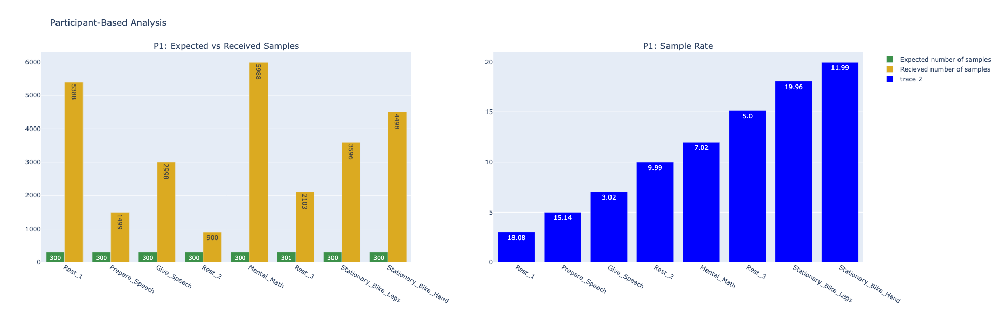

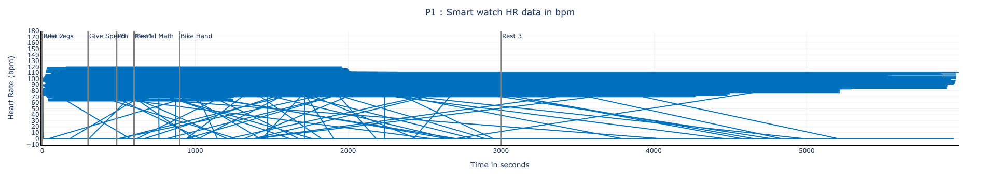

b'Skipping line 2042: expected 3 fields, saw 4\nSkipping line 2642: expected 3 fields, saw 4\nSkipping line 3542: expected 3 fields, saw 4\nSkipping line 3782: expected 3 fields, saw 4\n'
b'Skipping line 183: expected 3 fields, saw 4\n'
b'Skipping line 543: expected 3 fields, saw 4\n'
b'Skipping line 201: expected 3 fields, saw 4\nSkipping line 1099: expected 3 fields, saw 5\nSkipping line 1697: expected 3 fields, saw 5\nSkipping line 1896: expected 3 fields, saw 5\n'
b'Skipping line 2038: expected 3 fields, saw 4\nSkipping line 2277: expected 3 fields, saw 4\n'
b'Skipping line 1440: expected 3 fields, saw 5\n'
b'Skipping line 843: expected 3 fields, saw 5\n'
b'Skipping line 1435: expected 3 fields, saw 4\nSkipping line 2635: expected 3 fields, saw 4\n'


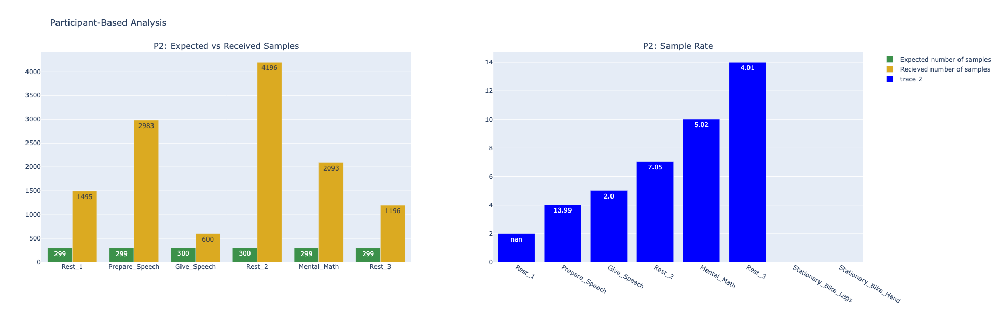

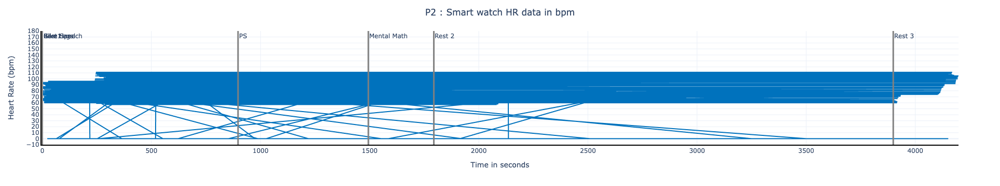

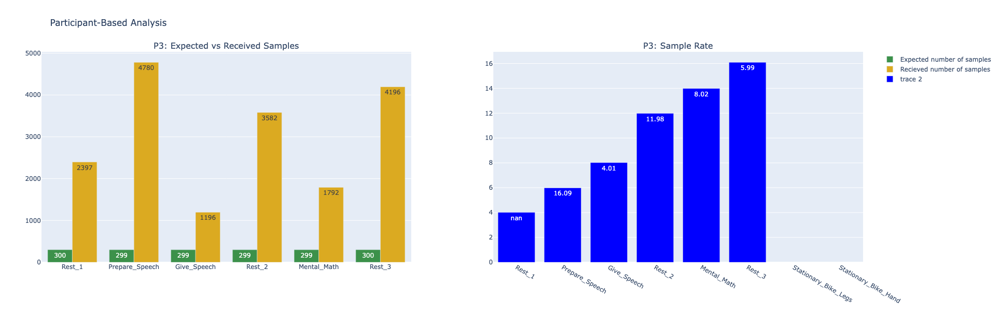

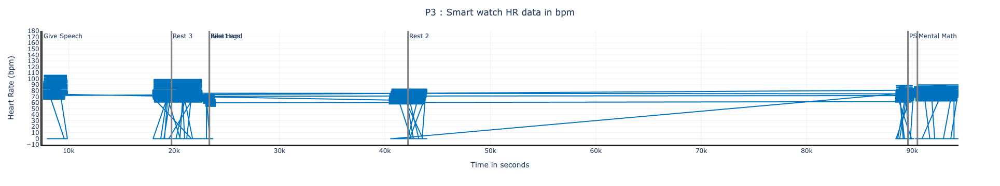

b'Skipping line 187: expected 3 fields, saw 4\n'
b'Skipping line 249: expected 3 fields, saw 4\n'
b'Skipping line 838: expected 3 fields, saw 4\nSkipping line 3238: expected 3 fields, saw 4\n'
b'Skipping line 3539: expected 3 fields, saw 4\nSkipping line 4137: expected 3 fields, saw 4\nSkipping line 4385: expected 3 fields, saw 4\n'
b'Skipping line 2943: expected 3 fields, saw 5\nSkipping line 5343: expected 3 fields, saw 5\nSkipping line 6243: expected 3 fields, saw 5\n'
b'Skipping line 201: expected 3 fields, saw 4\nSkipping line 401: expected 3 fields, saw 4\nSkipping line 2284: expected 3 fields, saw 5\nSkipping line 3778: expected 3 fields, saw 5\n'
b'Skipping line 528: expected 3 fields, saw 5\nSkipping line 1428: expected 3 fields, saw 4\nSkipping line 2624: expected 3 fields, saw 4\nSkipping line 3222: expected 3 fields, saw 4\n'
b'Skipping line 1965: expected 3 fields, saw 5\nSkipping line 2128: expected 3 fields, saw 5\nSkipping line 3465: expected 3 fields, saw 5\nSkipping l

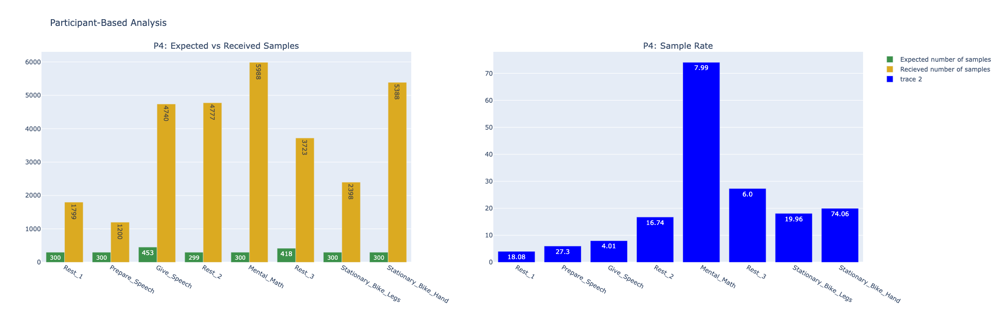

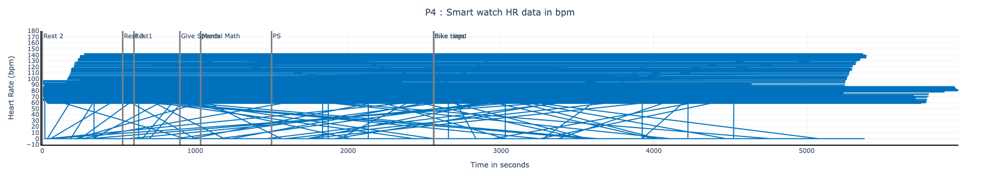

b'Skipping line 541: expected 3 fields, saw 4\nSkipping line 781: expected 3 fields, saw 4\nSkipping line 1021: expected 3 fields, saw 4\nSkipping line 1561: expected 3 fields, saw 4\n'
b'Skipping line 233: expected 3 fields, saw 4\n'
b'Skipping line 1144: expected 3 fields, saw 5\nSkipping line 2044: expected 3 fields, saw 5\n'
b'Skipping line 465: expected 3 fields, saw 5\nSkipping line 628: expected 3 fields, saw 5\nSkipping line 2265: expected 3 fields, saw 5\nSkipping line 3165: expected 3 fields, saw 5\nSkipping line 4065: expected 3 fields, saw 5\nSkipping line 4965: expected 3 fields, saw 5\nSkipping line 5565: expected 3 fields, saw 5\nSkipping line 6765: expected 3 fields, saw 5\nSkipping line 6928: expected 3 fields, saw 5\nSkipping line 7091: expected 3 fields, saw 5\n'
b'Skipping line 530: expected 3 fields, saw 4\nSkipping line 1132: expected 3 fields, saw 4\nSkipping line 2035: expected 3 fields, saw 4\nSkipping line 2262: expected 3 fields, saw 4\nSkipping line 3841: ex

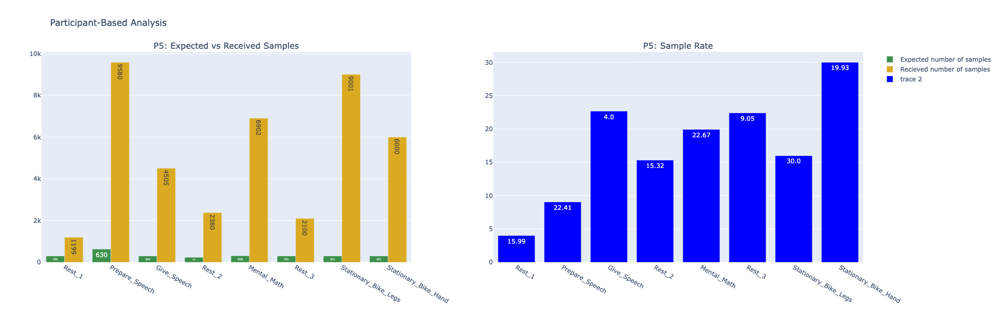

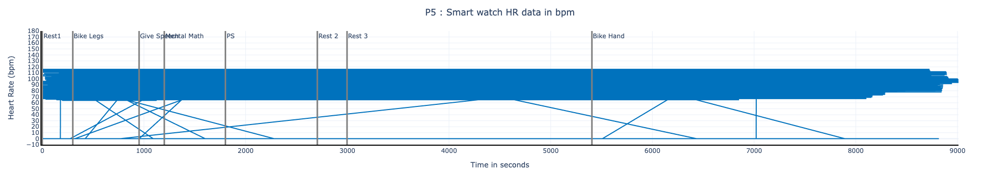

b'Skipping line 542: expected 3 fields, saw 5\nSkipping line 1742: expected 3 fields, saw 5\nSkipping line 2342: expected 3 fields, saw 5\nSkipping line 4442: expected 3 fields, saw 5\nSkipping line 5642: expected 3 fields, saw 5\n'
b'Skipping line 529: expected 3 fields, saw 4\n'
b'Skipping line 2343: expected 3 fields, saw 5\n'
b'Skipping line 1142: expected 3 fields, saw 5\nSkipping line 1382: expected 3 fields, saw 5\n'
b'Skipping line 249: expected 3 fields, saw 4\nSkipping line 2651: expected 3 fields, saw 4\nSkipping line 3251: expected 3 fields, saw 4\n'
b'Skipping line 1744: expected 3 fields, saw 5\nSkipping line 2944: expected 3 fields, saw 5\n'
b'Skipping line 2629: expected 3 fields, saw 4\n'
b'Skipping line 1701: expected 3 fields, saw 5\nSkipping line 1900: expected 3 fields, saw 5\n'
b'Skipping line 1755: expected 3 fields, saw 4\nSkipping line 2357: expected 3 fields, saw 4\nSkipping line 3260: expected 3 fields, saw 4\nSkipping line 4765: expected 3 fields, saw 4\n'
b

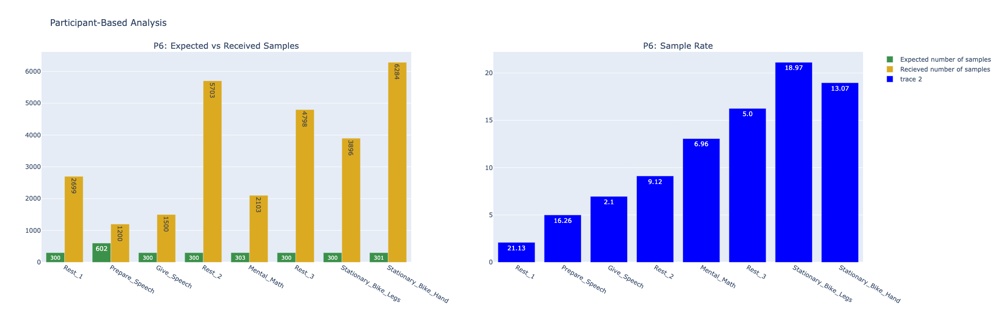

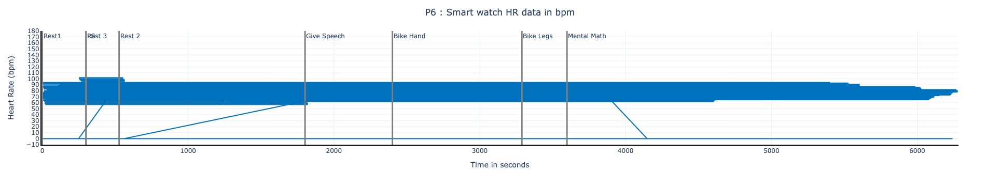

b'Skipping line 3239: expected 3 fields, saw 5\nSkipping line 3839: expected 3 fields, saw 5\nSkipping line 4439: expected 3 fields, saw 5\nSkipping line 5339: expected 3 fields, saw 5\n'
b'Skipping line 465: expected 3 fields, saw 5\nSkipping line 2265: expected 3 fields, saw 5\nSkipping line 3165: expected 3 fields, saw 5\nSkipping line 4965: expected 3 fields, saw 5\n'
b'Skipping line 843: expected 3 fields, saw 5\nSkipping line 1083: expected 3 fields, saw 5\nSkipping line 2043: expected 3 fields, saw 5\nSkipping line 2643: expected 3 fields, saw 5\nSkipping line 2883: expected 3 fields, saw 5\nSkipping line 3123: expected 3 fields, saw 5\nSkipping line 5343: expected 3 fields, saw 5\nSkipping line 5583: expected 3 fields, saw 5\n'
b'Skipping line 242: expected 3 fields, saw 4\n'
b'Skipping line 2032: expected 3 fields, saw 4\nSkipping line 2259: expected 3 fields, saw 4\nSkipping line 3832: expected 3 fields, saw 4\nSkipping line 5032: expected 3 fields, saw 4\n'
b'Skipping line 2

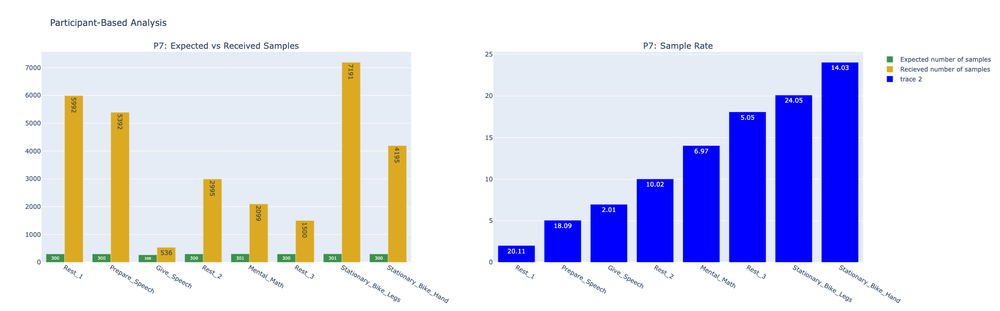

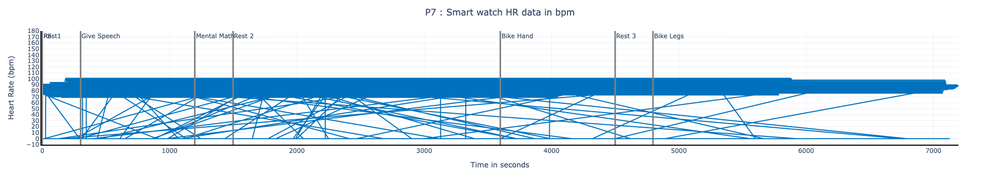

b'Skipping line 249: expected 3 fields, saw 4\nSkipping line 1133: expected 3 fields, saw 4\n'
b'Skipping line 964: expected 3 fields, saw 5\n'
b'Skipping line 493: expected 3 fields, saw 4\nSkipping line 737: expected 3 fields, saw 5\nSkipping line 981: expected 3 fields, saw 4\n'
b'Skipping line 235: expected 3 fields, saw 4\nSkipping line 469: expected 3 fields, saw 4\nSkipping line 703: expected 3 fields, saw 4\n'
b'Skipping line 242: expected 3 fields, saw 4\nSkipping line 483: expected 3 fields, saw 4\nSkipping line 724: expected 3 fields, saw 4\n'
b'Skipping line 235: expected 3 fields, saw 4\nSkipping line 469: expected 3 fields, saw 4\nSkipping line 937: expected 3 fields, saw 4\nSkipping line 1405: expected 3 fields, saw 4\n'
b'Skipping line 482: expected 3 fields, saw 5\nSkipping line 722: expected 3 fields, saw 5\nSkipping line 962: expected 3 fields, saw 5\n'
b'Skipping line 1291: expected 3 fields, saw 5\n'
b'Skipping line 555: expected 3 fields, saw 5\nSkipping line 795:

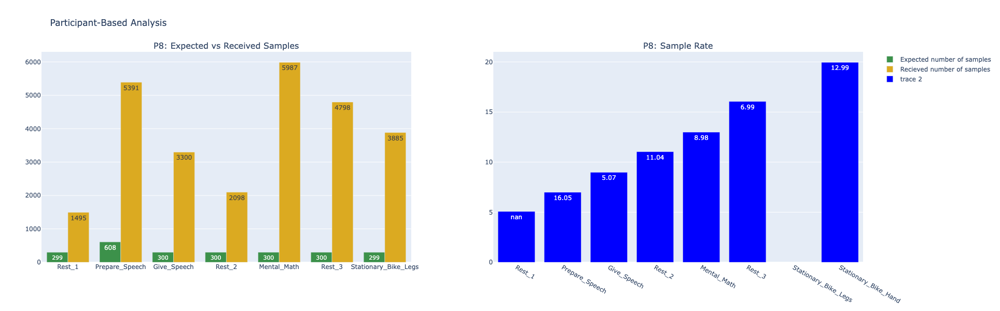

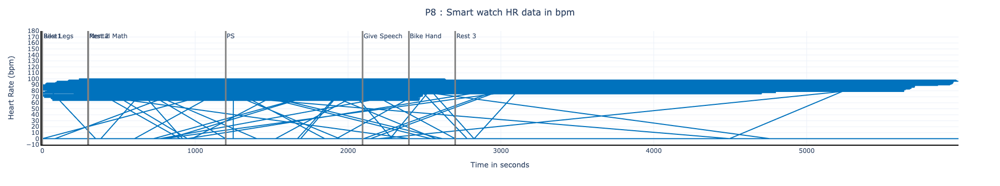

In [10]:
run_main(root_folder_str,root_data_set)

# Concat Data File Analysis:
- In this file all the activies are in one file per participants.

In [6]:
file_path = "/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/Concat_File/heart_rate_10-05-2024_P7.csv"
df = pd.read_csv(file_path)

In [7]:
df["activity"].unique()

array(['Stationary_Bike_Legs', 'Rest_3', 'Rest_1', 'Rest_2',
       'Give_Speech', 'Prepare_Speech', 'Stationary_Bike_Hand',
       'Mental_Math'], dtype=object)

In [14]:
folder_path = '/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/Concat_File'
file_type = 'csv'  # Change to 'xlsx', 'json', etc., as needed.
file_pattern = os.path.join(folder_path, f'*.{file_type}')
files_concat = glob.glob(file_pattern)
files_concat

['/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/Concat_File/heart_rate_09-10-24_P6.csv',
 '/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/Concat_File/heart_rate_10-05-2024_P7.csv',
 '/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/Concat_File/heart_rate_05-09-2024_P4.csv',
 '/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/Concat_File/heart_rate_08-21-24_P2.csv',
 '/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/Concat_File/heart_rate_09-11-2024_P1.csv',
 '/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/Concat_File/heart_rate_08_29_24_P3.csv']

### Plot Raw HR data

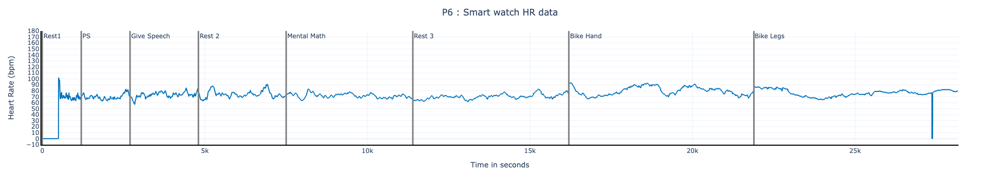

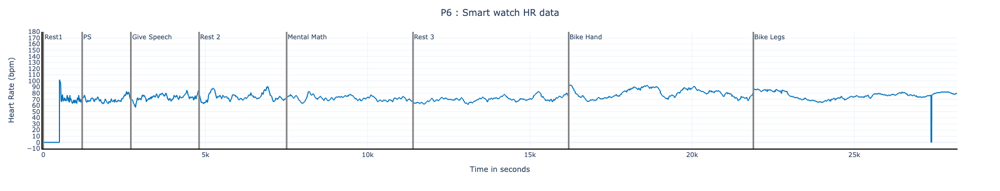

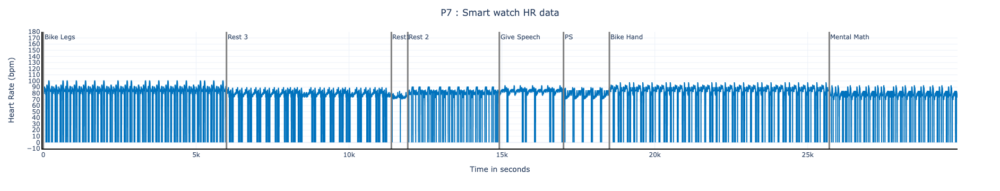

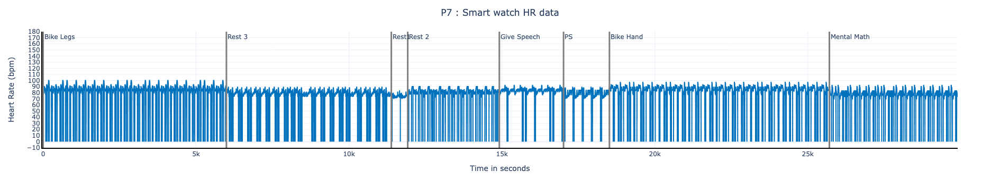

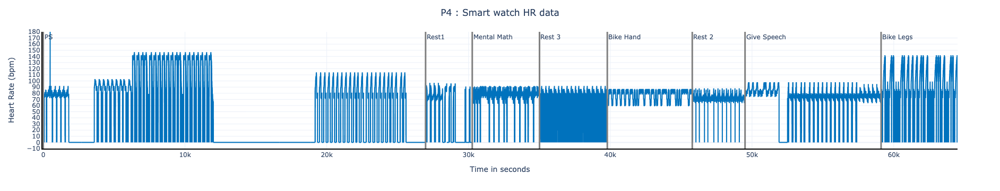

...

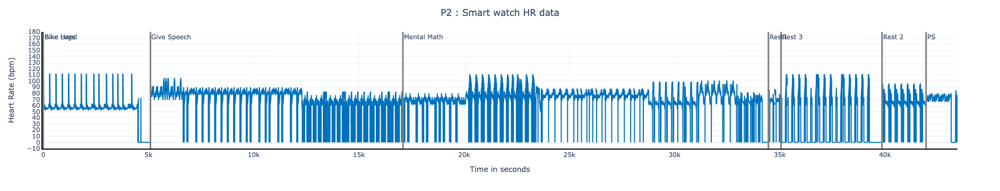

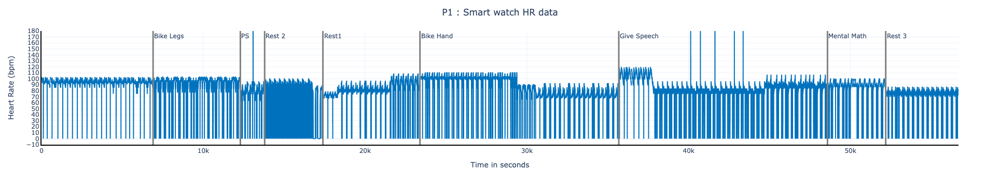

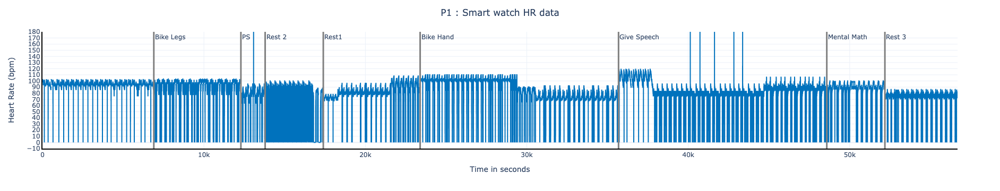

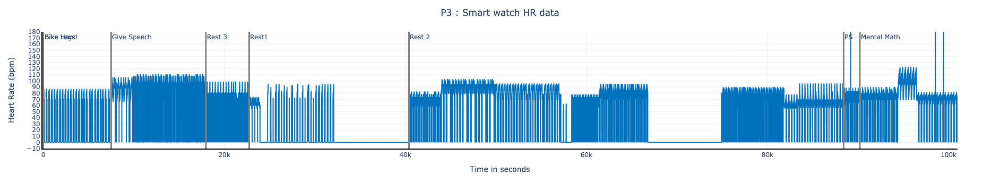

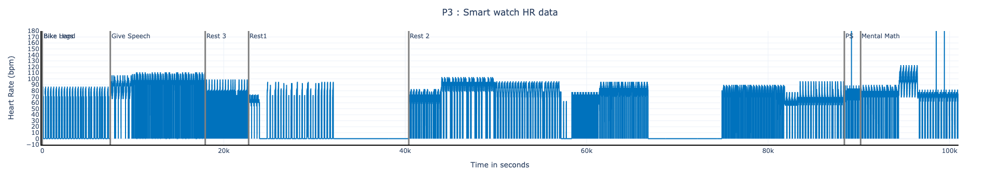

In [16]:
for i in files_concat: # Read all files in the / Concat_Files folder.
    df = pd.read_csv(i)
    fig = plot_raw_data(df)
    fig.show()
#     # Get the first ouxxurence of the task
#     rest_1_first_occurrence_index_df = (df['activity'] == 'Rest_1').idxmax() #df[df['activity'] == 'Rest_1'].index[0]
#     prepare_speech_first_occurrence_index_df = (df['activity'] == 'Prepare_Speech').idxmax()
#     give_speech_first_occurrence_index_df = (df['activity'] == 'Give_Speech').idxmax()
#     rest_2_first_occurrence_index_df = (df['activity'] == 'Rest_2').idxmax()  #df[df['activity'] == 'Rest_3'].index[0]

#     mental_math_first_occurrence_index_df = (df['activity'] == 'Mental_Math').idxmax()
#     rest_3_first_occurrence_index_df = (df['activity'] == 'Rest_3').idxmax()  #df[df['activity'] == 'Prepare_Speech'].index[0]
#     stationary_bike_hand_first_occurrence_index_df = (df['activity'] == 'Stationary_Bike_Hand').idxmax()
#     bike_legs_first_occurrence_index_df = (df['activity'] == 'Stationary_Bike_Legs').idxmax() #df[df['activity'] == 'Stationary_Bike_Legs'].index[0]
#     print("bike_legs_first_occurrence_index_df: ",bike_legs_first_occurrence_index_df)
#     print("stationary_bike_hand_first_occurrence_index_df: ",stationary_bike_hand_first_occurrence_index_df)
#     fig1 = px.line(df, y="heart_rate_float",line_shape="linear", color_discrete_sequence=['#0072BD'],template="plotly_white")

#     fig1.add_vline(x=rest_1_first_occurrence_index_df,  annotation_text="Rest1", line_width=3, line_dash="solid", line_color="grey")
#     fig1.add_vline(x=prepare_speech_first_occurrence_index_df, annotation_text="PS",line_width=3, line_dash="solid", line_color="grey")
#     fig1.add_vline(x=give_speech_first_occurrence_index_df,annotation_text="Give Speech", line_width=3, line_dash="solid", line_color="grey")
#     fig1.add_vline(x=rest_2_first_occurrence_index_df,annotation_text="Rest 2", line_width=3,line_dash="solid", line_color="grey")
#     fig1.add_vline(x=mental_math_first_occurrence_index_df, annotation_text="Mental Math",line_width=3,line_dash="solid", line_color="grey")
#     fig1.add_vline(x=rest_3_first_occurrence_index_df,annotation_text="Rest 3", line_width=3, line_dash="solid", line_color="grey")
#     fig1.add_vline(x=stationary_bike_hand_first_occurrence_index_df,annotation_text="Bike Hand", line_width=3, line_dash="solid", line_color="grey")
#     fig1.add_vline(x=bike_legs_first_occurrence_index_df, annotation_text="Bike Legs",line_width=3, line_dash="solid", line_color="grey")
#     # fig1.update_yaxes(title_text='Heart Rate (bpm)', range=[40, 180], tickmode='linear', dtick=10)
#     fig1.update_yaxes(title_text='Heart Rate (bpm)', range=[-10, 180], tickmode='linear', dtick=10)

#     # Update layout to adjust title position and distance from plot
#     fig1.update_layout(
#             xaxis=dict(
#             title="Time in seconds",               # Title for the x-axis
#             showline=True,              # Show x-axis line
#             linecolor='black',          # Color of x-axis line
#             linewidth=2,                # Width of x-axis line
#            # mirror=True                 # Mirror the axis line (to extend it across the top of the plot)
#         ),
#         yaxis=dict(
#             title="Heart Rate (bpm)",    # Title for the y-axis
#             showline=True,               # Show y-axis line
#             linecolor='black',           # Color of y-axis line
#             linewidth=2,                 # Width of y-axis line
#            # mirror=True                  # Mirror the axis line (to extend it across the right side of the plot)
#         ),
#         title={
#             'text': i.split("/")[-1].split("_")[-1].split(".")[0] + " : Smart watch HR data",
#             'x': 0.5,               # Center the title horizontally
#             'xanchor': 'center',
#             'y': 0.95,              # Adjust vertical position (closer to plot)
#             'yanchor': 'top',        # Set anchor point to top
#             'pad': {'b': 10}         # Adjust padding (decrease distance)
#         }
#     )
#     # Show the plot
#     fig1.show()


### Sample rate analysis for all the participants

In [13]:
################################################################################################
# For overall analysis of /StudyData_Drive_2024/Concat_File/ 
# ALl the heart_rate data is in this folder concatinated by activity.
################################################################################################
pid_average_list = []
percentage_zeros_list = []
sample_rate__df = []
for i in files_concat: # Read all files in the / Concat_Files folder.
    df = pd.read_csv(i)
    df_activity = df[df['activity'].isin(['Give_Speech', 'Stationary_Bike_Hand','Stationary_Bike_Legs','Mental_Math','Rest_1', 'Rest_3', 'Rest_2', 'Prepare_Speech'])]
    for activity in ['Give_Speech', 'Stationary_Bike_Hand','Stationary_Bike_Legs','Mental_Math','Rest_1', 'Rest_3', 'Rest_2', 'Prepare_Speech']:
        # WRITE EACH ACTIVITY FILE SEPERATELY.
        df[df["activity"]==activity].to_csv("/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/Sepereated_by_activity/" + activity +"_" + i.split("/")[-1].split("_")[-1].split(".")[0] + ".csv")
    # Group by 'Group' column and take the mean of the 'Value' column.
    grouped_mean = df_activity.groupby('activity')['heart_rate_float'].mean()
    type(grouped_mean)
    grouped_mean_df = grouped_mean.reset_index()
    grouped_mean_df["participantID"] = i.split("/")[-1].split("_")[-1].split(".")[0]
    pid_average_list.append(grouped_mean_df)
    percentage_zeros = df_activity.groupby('activity').apply(lambda x: (x['heart_rate_float'] == 0).sum() / len(x) * 100)
    percentage_zeros_df = percentage_zeros.reset_index(name='Percentage_zeros')
    percentage_zeros_df["participantID"] = i.split("/")[-1].split("_")[-1].split(".")[0]
    percentage_zeros_list.append(percentage_zeros_df)
    # Group by 'activity' and calculate the mean of value_counts() for each group
    mean_value_counts_per_group = df_activity.groupby('activity').apply(
        lambda x: x['seconds_timestamp'].value_counts().mean()
    )
    # Convert to DataFrame if needed
    mean_value_counts_df = mean_value_counts_per_group.reset_index(name='SampleRate')
    mean_value_counts_df["participantID"] = i.split("/")[-1].split("_")[-1].split(".")[0]
    sample_rate__df.append(mean_value_counts_df)
    print(mean_value_counts_df)


In [14]:
# Create data frame for the percentage of 0s and sample rate for each particiapnt for the Bar plot format.
percentage_zeros_list_all = pd.concat(percentage_zeros_list)
sample_rate_concat_df = pd.concat(sample_rate__df)

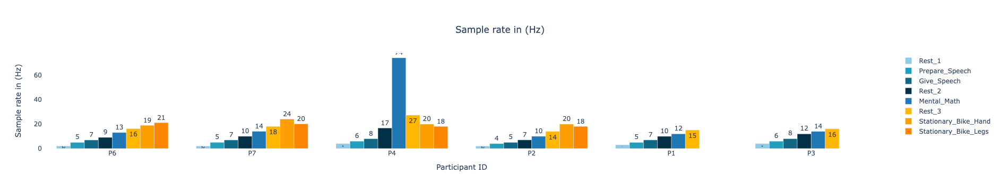

In [15]:

pid_list=percentage_zeros_list_all["participantID"].unique()
fig = go.Figure(data=[
    go.Bar(name='Rest_1', x=pid_list,
        text=sample_rate_concat_df[sample_rate_concat_df["activity"] == "Rest_1"]["SampleRate"].round(0).astype(int),  # Text on the bars\
           y=sample_rate_concat_df[sample_rate_concat_df["activity"]=="Rest_1"]["SampleRate"],
                  textposition='inside',  # Ensure text appears even for 0
           marker=dict(color='#8ecae6')),
    go.Bar(name='Prepare_Speech', x=pid_list,
                   text=sample_rate_concat_df[sample_rate_concat_df["activity"] == "Prepare_Speech"]["SampleRate"].round(0).astype(int),
        textposition='outside',  # Ensure text appears even for 0

           y=sample_rate_concat_df[sample_rate_concat_df["activity"]=="Prepare_Speech"]["SampleRate"],
          marker=dict(color='#219ebc')),
    go.Bar(name='Give_Speech', x=pid_list,
                   text=sample_rate_concat_df[sample_rate_concat_df["activity"] == "Give_Speech"]["SampleRate"].round(0).astype(int),
        textposition='outside',  # Ensure text appears even for 0

           y=sample_rate_concat_df[sample_rate_concat_df["activity"]=="Give_Speech"]["SampleRate"],
          marker=dict(color='#126782')),
    go.Bar(name='Rest_2', x=pid_list,
                   text=sample_rate_concat_df[sample_rate_concat_df["activity"] == "Rest_2"]["SampleRate"].round(0).astype(int),
                   textposition='outside',  # Ensure text appears even for 0

           y=sample_rate_concat_df[sample_rate_concat_df["activity"]=="Rest_2"]["SampleRate"],
          marker=dict(color='#023047')),
    go.Bar(name='Mental_Math', 
            text=sample_rate_concat_df[sample_rate_concat_df["activity"] == "Mental_Math"]["SampleRate"].round(0).astype(int),
                   textposition='outside',  # Ensure text appears even for 0

           x=pid_list, y=sample_rate_concat_df[sample_rate_concat_df["activity"]=="Mental_Math"]["SampleRate"],
          marker=dict(color='#1f77b4')),
    go.Bar(name='Rest_3', 
           x=pid_list, 
            text=sample_rate_concat_df[sample_rate_concat_df["activity"] == "Rest_3"]["SampleRate"].round(0).astype(int),
           y=sample_rate_concat_df[sample_rate_concat_df["activity"]=="Rest_3"]["SampleRate"],
          marker=dict(color='#ffb703')),
    go.Bar(name='Stationary_Bike_Hand', x=pid_list, 
            text=sample_rate_concat_df[sample_rate_concat_df["activity"] == "Stationary_Bike_Hand"]["SampleRate"].round(0).astype(int),
        textposition='outside',  # Ensure text appears even for 0

           y=sample_rate_concat_df[sample_rate_concat_df["activity"]=="Stationary_Bike_Hand"]["SampleRate"],
          marker=dict(color='#fd9e02')),
    go.Bar(name='Stationary_Bike_Legs', x=pid_list, 
        text=sample_rate_concat_df[sample_rate_concat_df["activity"] == "Stationary_Bike_Legs"]["SampleRate"].round(0).astype(int),
           textposition='outside',
           y=sample_rate_concat_df[sample_rate_concat_df["activity"]=="Stationary_Bike_Legs"]["SampleRate"],
          marker=dict(color='#fb8500')),

])
# Change the bar mode
fig.update_layout(barmode='group',    
                  plot_bgcolor='white',  # Set plot background color to white
                  paper_bgcolor='white',  # Set figure background color to white
                  xaxis_title="Participant ID",  # Add x-axis title
                  yaxis_title="Sample rate in (Hz)",  # Add x-axis title
                  title={
                      'text': "Sample rate in (Hz)",  # Plot title
                      'x': 0.5,  # Center the title
                      'xanchor': 'center',
                      'yanchor': 'top'
                    }

)
fig.show()

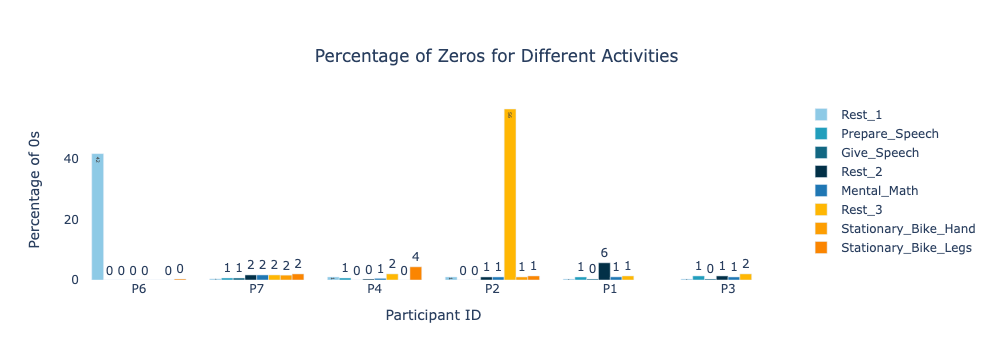

In [59]:
pid_list=percentage_zeros_list_all["participantID"].unique()
fig = go.Figure(data=[
    go.Bar(name='Rest_1', x=pid_list,
        text=percentage_zeros_list_all[percentage_zeros_list_all["activity"] == "Rest_1"]["Percentage_zeros"].round(0).astype(int),  # Text on the bars\
           y=percentage_zeros_list_all[percentage_zeros_list_all["activity"]=="Rest_1"]["Percentage_zeros"],
                  textposition='inside',  # Ensure text appears even for 0
           marker=dict(color='#8ecae6')),
    go.Bar(name='Prepare_Speech', x=pid_list,
                   text=percentage_zeros_list_all[percentage_zeros_list_all["activity"] == "Prepare_Speech"]["Percentage_zeros"].round(0).astype(int),
        textposition='outside',  # Ensure text appears even for 0

           y=percentage_zeros_list_all[percentage_zeros_list_all["activity"]=="Prepare_Speech"]["Percentage_zeros"],
          marker=dict(color='#219ebc')),
    go.Bar(name='Give_Speech', x=pid_list,
                   text=percentage_zeros_list_all[percentage_zeros_list_all["activity"] == "Give_Speech"]["Percentage_zeros"].round(0).astype(int),
        textposition='outside',  # Ensure text appears even for 0

           y=percentage_zeros_list_all[percentage_zeros_list_all["activity"]=="Give_Speech"]["Percentage_zeros"],
          marker=dict(color='#126782')),
    go.Bar(name='Rest_2', x=pid_list,
                   text=percentage_zeros_list_all[percentage_zeros_list_all["activity"] == "Rest_2"]["Percentage_zeros"].round(0).astype(int),
                   textposition='outside',  # Ensure text appears even for 0

           y=percentage_zeros_list_all[percentage_zeros_list_all["activity"]=="Rest_2"]["Percentage_zeros"],
          marker=dict(color='#023047')),
    go.Bar(name='Mental_Math', 
            text=percentage_zeros_list_all[percentage_zeros_list_all["activity"] == "Mental_Math"]["Percentage_zeros"].round(0).astype(int),
                   textposition='outside',  # Ensure text appears even for 0

           x=pid_list, y=percentage_zeros_list_all[percentage_zeros_list_all["activity"]=="Mental_Math"]["Percentage_zeros"],
          marker=dict(color='#1f77b4')),
    go.Bar(name='Rest_3', 
           x=pid_list, 
            text=percentage_zeros_list_all[percentage_zeros_list_all["activity"] == "Rest_3"]["Percentage_zeros"].round(0).astype(int),
           y=percentage_zeros_list_all[percentage_zeros_list_all["activity"]=="Rest_3"]["Percentage_zeros"],
          marker=dict(color='#ffb703')),
    go.Bar(name='Stationary_Bike_Hand', x=pid_list, 
            text=percentage_zeros_list_all[percentage_zeros_list_all["activity"] == "Stationary_Bike_Hand"]["Percentage_zeros"].round(0).astype(int),
        textposition='outside',  # Ensure text appears even for 0

           y=percentage_zeros_list_all[percentage_zeros_list_all["activity"]=="Stationary_Bike_Hand"]["Percentage_zeros"],
          marker=dict(color='#fd9e02')),
    go.Bar(name='Stationary_Bike_Legs', x=pid_list, 
        text=percentage_zeros_list_all[percentage_zeros_list_all["activity"] == "Stationary_Bike_Legs"]["Percentage_zeros"].round(0).astype(int),
           textposition='outside',
           y=percentage_zeros_list_all[percentage_zeros_list_all["activity"]=="Stationary_Bike_Legs"]["Percentage_zeros"],
          marker=dict(color='#fb8500')),

])
# Change the bar mode
fig.update_layout(barmode='group',    
                  plot_bgcolor='white',  # Set plot background color to white
                  paper_bgcolor='white',  # Set figure background color to white
                  xaxis_title="Participant ID",  # Add x-axis title
                  yaxis_title="Percentage of 0s",  # Add x-axis title
                  title={
                      'text': "Percentage of Zeros for Different Activities",  # Plot title
                      'x': 0.5,  # Center the title
                      'xanchor': 'center',
                      'yanchor': 'top'
                    }
)
fig.show()

In [53]:
# Average HeartRate for the entire dataset.
feature_average = pd.concat(pid_average_list)

In [54]:
feature_average

,activity,heart_rate_float,participantID
0,Give_Speech,73.350785,P6
1,Mental_Math,71.880133,P6
2,Prepare_Speech,69.816667,P6
3,Rest_1,41.263333,P6
4,Rest_2,74.315672,P6
5,Rest_3,70.357857,P6
6,Stationary_Bike_Hand,79.879325,P6
7,Stationary_Bike_Legs,76.197737,P6
0,Give_Speech,83.721640,P7
1,Mental_Math,78.285578,P7


In [55]:
feature_average_subset = feature_average[feature_average['activity'].isin(['Give_Speech', 'Stationary_Bike_Hand','Stationary_Bike_Legs','Mental_Math','Rest_1', 'Rest_3', 'Rest_2', 'Prepare_Speech'])]


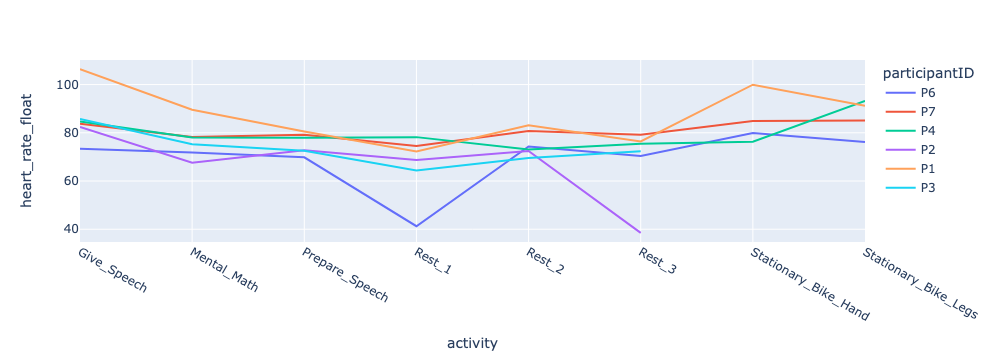

In [56]:
# df = px.data.gapminder().query("continent=='Oceania'")
fig = px.line(feature_average_subset, x="activity", y="heart_rate_float", color='participantID')
fig.show()

In [57]:
df_sorted["activity"].unique()

NameError: name 'df_sorted' is not defined

In [84]:
df_sorted

,Unnamed: 0,HeartRate,Timestamp,activity,filename,time,date,seconds_timestamp,heart_rate_float
23940,0,0.0,2024-08-29 13:25:07.089,None,heart_rate_2024-08-29_13_30_06.7512024-08-29_1...,13:25:07.089,2024-08-29,13:25:07,0.0
24240,300,0.0,2024-08-29 13:25:07.089,None,heart_rate_2024-08-29_13_30_06.7512024-08-29_1...,13:25:07.089,2024-08-29,13:25:07,0.0
23941,1,0.0,2024-08-29 13:25:08.091,None,heart_rate_2024-08-29_13_30_06.7512024-08-29_1...,13:25:08.091,2024-08-29,13:25:08,0.0
24241,301,0.0,2024-08-29 13:25:08.091,None,heart_rate_2024-08-29_13_30_06.7512024-08-29_1...,13:25:08.091,2024-08-29,13:25:08,0.0
23942,2,0.0,2024-08-29 13:25:09.098,None,heart_rate_2024-08-29_13_30_06.7512024-08-29_1...,13:25:09.098,2024-08-29,13:25:09,0.0
...,...,...,...,...,...,...,...,...,...
88775,370,72.0,2024-946,Prepare_Speech,heart_rate_2024-08-29_13_55_17.9152024-08-29_1...,NaN,2024-946,NaN,72.0
88889,484,HeartRate,Timestamp,activity,heart_rate_2024-08-29_13_55_17.9152024-08-29_1...,NaN,Timestamp,NaN,NaN
89188,783,946,Prepare_Speech,NaN,heart_rate_2024-08-29_13_55_17.9152024-08-29_1...,NaN,Prepare_Speech,NaN,946.0
93097,2898,_Math,NaN,NaN,heart_rate_2024-08-29_14_20_48.3452024-08-29_1...,NaN,NaN,NaN,NaN


In [85]:
# df_sorted[df_sorted["activity"]=="Stationary_Bike"].to_csv("/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/stationary_bike_P3.csv")


In [86]:
# Sort the DataFrame by the 'time' column
df_sorted = df.sort_values(by='time')
df_reindexed = df_sorted.reset_index(drop=True)
subset_df = df_reindexed[df_reindexed['activity'].isin(['Prepare_Speech','Give_Speech', 'Stationary_Bike_Hand','Stationary_Bike_Legs','Mental_Math','Rest_1', 'Rest_3', 'Rest_2'])]
subset_df["activity"].unique()

array(['Rest_1', 'Prepare_Speech', 'Give_Speech', 'Rest_2', 'Mental_Math',
       'Rest_3', 'Stationary_Bike_Legs'], dtype=object)

In [88]:
# Check for NaN values in the entire dataframe
print(subset_df.isnull().sum())

# Check specifically for NaN values in the 'heart_rate_float' column
print(subset_df['heart_rate_float'].isnull().sum())

Unnamed: 0               0
HeartRate                2
Timestamp                0
activity                 0
filename                 0
time                     0
date                     0
seconds_timestamp        0
Unnamed: 3           21881
Unnamed: 4           21881
heart_rate_float         2
dtype: int64
2


In [89]:

nan_rows = subset_df[subset_df['heart_rate_float'].isnull()]
print(nan_rows)

      Unnamed: 0  HeartRate                Timestamp     activity  \
4096         801        NaN  2024-10-09 14:06:11.901  Give_Speech   
4097         700        NaN  2024-10-09 14:06:11.901  Give_Speech   

                                               filename          time  \
4096  heart_rate_2024-10-09_14_07_55.9232024-10-09_1...  14:06:11.901   
4097  heart_rate_2024-10-09_14_07_55.9232024-10-09_1...  14:06:11.901   

            date seconds_timestamp  Unnamed: 3  Unnamed: 4  heart_rate_float  
4096  2024-10-09          14:06:11         NaN         NaN               NaN  
4097  2024-10-09          14:06:11         NaN         NaN               NaN  


In [90]:
subset_df_cleaned = subset_df.dropna(subset=['heart_rate_float'])


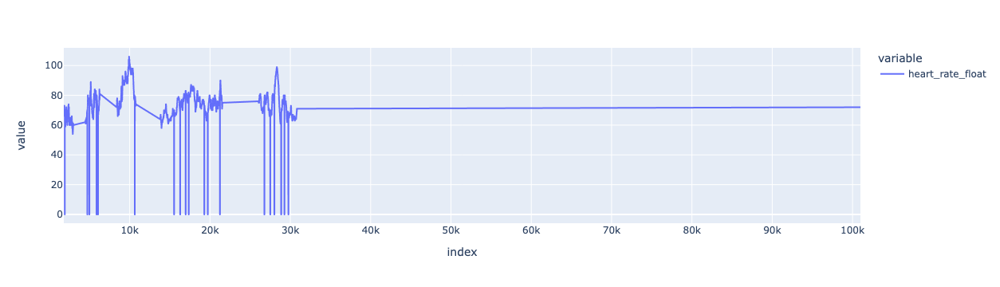

In [72]:

px.line(subset_df_cleaned["heart_rate_float"])

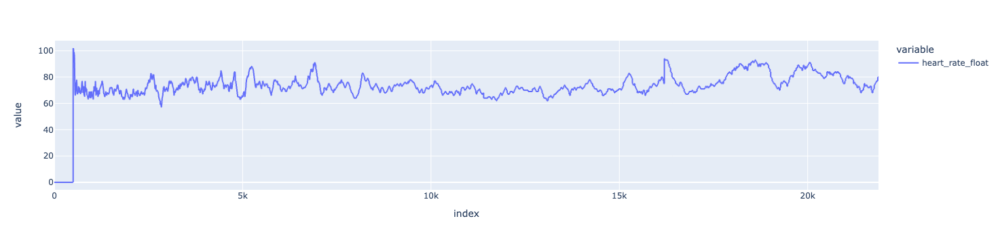

In [69]:
px.line(df["heart_rate_float"])

In [55]:
subset_df[subset_df["activity"]=="Rest_3"]

,Unnamed: 0,HeartRate,Timestamp,activity,filename,time,date,seconds_timestamp,heart_rate_float
26042,299,76.0,2024-08-29 14:26:12.503,Rest_3,heart_rate_2024-08-29_14_31_12.0802024-08-29_1...,14:26:12.503,2024-08-29,14:26:12,76.0
26043,0,76.0,2024-08-29 14:26:12.503,Rest_3,heart_rate_2024-08-29_14_31_12.0802024-08-29_1...,14:26:12.503,2024-08-29,14:26:12,76.0
26044,897,76.0,2024-08-29 14:26:12.503,Rest_3,heart_rate_2024-08-29_14_31_12.0802024-08-29_1...,14:26:12.503,2024-08-29,14:26:12,76.0
26045,4483,76.0,2024-08-29 14:26:12.503,Rest_3,heart_rate_2024-08-29_14_31_12.0802024-08-29_1...,14:26:12.503,2024-08-29,14:26:12,76.0
26046,2392,76.0,2024-08-29 14:26:12.503,Rest_3,heart_rate_2024-08-29_14_31_12.0802024-08-29_1...,14:26:12.503,2024-08-29,14:26:12,76.0
...,...,...,...,...,...,...,...,...,...
30817,3884,71.0,2024-08-29 14:31:11.182,Rest_3,heart_rate_2024-08-29_14_31_12.0802024-08-29_1...,14:31:11.182,2024-08-29,14:31:11,71.0
30818,896,71.0,2024-08-29 14:31:11.182,Rest_3,heart_rate_2024-08-29_14_31_12.0802024-08-29_1...,14:31:11.182,2024-08-29,14:31:11,71.0
30819,597,71.0,2024-08-29 14:31:11.182,Rest_3,heart_rate_2024-08-29_14_31_12.0802024-08-29_1...,14:31:11.182,2024-08-29,14:31:11,71.0
30820,1195,71.0,2024-08-29 14:31:11.182,Rest_3,heart_rate_2024-08-29_14_31_12.0802024-08-29_1...,14:31:11.182,2024-08-29,14:31:11,71.0


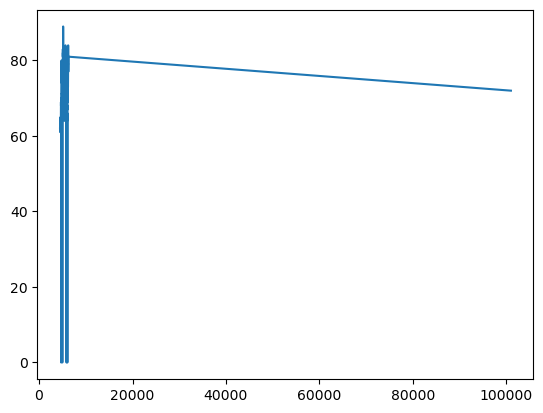

In [58]:
plt.plot(subset_df[subset_df["activity"]=="Prepare_Speech"]["heart_rate_float"])

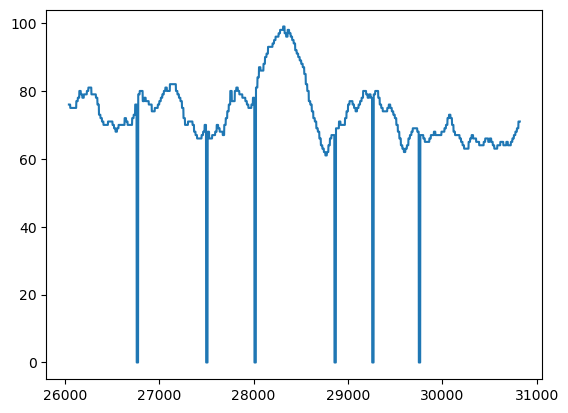

In [59]:
plt.plot(subset_df[subset_df["activity"]=="Rest_3"]["heart_rate_float"])

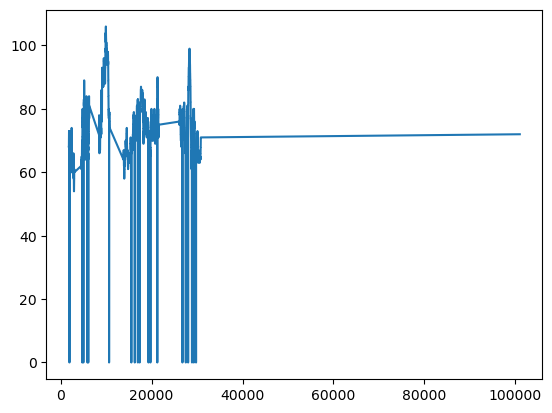

In [60]:
plt.plot(subset_df["heart_rate_float"])

In [61]:
subset_df[subset_df["activity"]=="Rest_1"][100:]

,Unnamed: 0,HeartRate,Timestamp,activity,filename,time,date,seconds_timestamp,heart_rate_float
1894,623,68.0,2024-08-29 13:40:37.376,Rest_1,heart_rate_2024-08-29_13_45_11.7682024-08-29_1...,13:40:37.376,2024-08-29,13:40:37,68.0
1895,922,68.0,2024-08-29 13:40:37.376,Rest_1,heart_rate_2024-08-29_13_45_11.7682024-08-29_1...,13:40:37.376,2024-08-29,13:40:37,68.0
1896,324,68.0,2024-08-29 13:40:37.376,Rest_1,heart_rate_2024-08-29_13_45_11.7682024-08-29_1...,13:40:37.376,2024-08-29,13:40:37,68.0
1897,25,68.0,2024-08-29 13:40:37.376,Rest_1,heart_rate_2024-08-29_13_45_11.7682024-08-29_1...,13:40:37.376,2024-08-29,13:40:37,68.0
1898,923,66.0,2024-08-29 13:40:38.388,Rest_1,heart_rate_2024-08-29_13_45_11.7682024-08-29_1...,13:40:38.388,2024-08-29,13:40:38,66.0
...,...,...,...,...,...,...,...,...,...
2985,1194,60.0,2024-08-29 13:45:10.025,Rest_1,heart_rate_2024-08-29_13_45_11.7682024-08-29_1...,13:45:10.025,2024-08-29,13:45:10,60.0
2986,896,60.0,2024-08-29 13:45:11.027,Rest_1,heart_rate_2024-08-29_13_45_11.7682024-08-29_1...,13:45:11.027,2024-08-29,13:45:11,60.0
2987,298,60.0,2024-08-29 13:45:11.027,Rest_1,heart_rate_2024-08-29_13_45_11.7682024-08-29_1...,13:45:11.027,2024-08-29,13:45:11,60.0
2988,1195,60.0,2024-08-29 13:45:11.027,Rest_1,heart_rate_2024-08-29_13_45_11.7682024-08-29_1...,13:45:11.027,2024-08-29,13:45:11,60.0


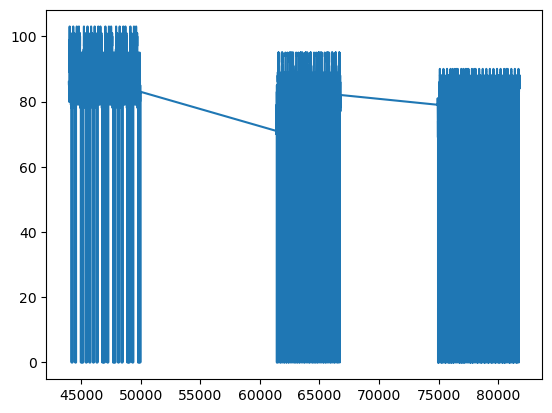

In [62]:
# df[df["activity"]=="Stationary_Bike"]
stationary_bike = df[df["activity"]=="Stationary_Bike"]
plt.plot(df[df["activity"]=="Stationary_Bike"].index,df[df["activity"]=="Stationary_Bike"]['heart_rate_float'])



In [63]:
df[df["activity"]=="Stationary_Bike"]

,Unnamed: 0,HeartRate,Timestamp,activity,filename,time,date,seconds_timestamp,heart_rate_float
43979,0,86.0,2024-08-29 14:41:51.653,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:41:51.653,2024-08-29,14:41:51,86.0
43980,1,85.0,2024-08-29 14:41:52.651,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:41:52.651,2024-08-29,14:41:52,85.0
43981,2,85.0,2024-08-29 14:41:53.653,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:41:53.653,2024-08-29,14:41:53,85.0
43982,3,85.0,2024-08-29 14:41:54.669,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:41:54.669,2024-08-29,14:41:54,85.0
43983,4,85.0,2024-08-29 14:41:55.656,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:41:55.656,2024-08-29,14:41:55,85.0
...,...,...,...,...,...,...,...,...,...
81810,6889,86.0,2024-08-29 14:52:03.007,Stationary_Bike,heart_rate_2024-08-29_14_52_07.4632024-08-29_1...,14:52:03.007,2024-08-29,14:52:03,86.0
81811,6890,86.0,2024-08-29 14:52:04.096,Stationary_Bike,heart_rate_2024-08-29_14_52_07.4632024-08-29_1...,14:52:04.096,2024-08-29,14:52:04,86.0
81812,6891,87.0,2024-08-29 14:52:04.995,Stationary_Bike,heart_rate_2024-08-29_14_52_07.4632024-08-29_1...,14:52:04.995,2024-08-29,14:52:04,87.0
81813,6892,87.0,2024-08-29 14:52:05.997,Stationary_Bike,heart_rate_2024-08-29_14_52_07.4632024-08-29_1...,14:52:05.997,2024-08-29,14:52:05,87.0


In [64]:
# # specfically for p3 subset into hands and legs.
subset1_leg = df.loc[61369:50000]
# df.loc[:50000]["activity"] ="Stationary_Bike_Legs"

# subset2_hand = df.loc[75000:89000]
# df.loc[75000:89000]["activity"] ="Stationary_Bike_Hands"

# # plt.plot(subset2_hand['heart_rate_float'])



In [65]:
df.columns

Index(['Unnamed: 0', 'HeartRate', 'Timestamp', 'activity', 'filename', 'time',
       'date', 'seconds_timestamp', 'heart_rate_float'],
      dtype='object')

In [ ]:
# input: activity_string: 
# one of the following: ['Rest_1', 'Prepare_Speech', 'Give_Speech', 'Mental_Math', 'Rest_3', 'Stationary_Bike_Legs', 'Stationary_Bike_Hand']
# Returns: data_downsampled:  a numpy nd arrary of HR values,df 5mins data downsampled to 1 Hz. 
def resample_by_activity(activity_string,subset_df):
    prepare_speech_sub_df = subset_df[subset_df['activity'] == activity_string]["heart_rate_float"]
    Fs_avg_ps = prepare_speech_sub_df.value_counts().mean()
    required_Fs = 1
    num_seconds = 300 # We need 5 Mins of data for each segment since each activity is 5 mins long.
    num_samples = prepare_speech_sub_df.shape[0] #int(num_seconds * Fs_avg_ps)  # Total number of samples at original rate
    time_index = pd.date_range('2024-09-01 00:00:00', periods=num_samples, freq=f'{1000/Fs_avg_ps:.3f}ms')
    desired_rate = 1  # Desired frequency (1 Hz)
    assert(len(time_index)==prepare_speech_sub_df.shape[0]) # check if the new timestamp index has the same number of samples as the original dataframe.
    # reset the index of the dataframe to the date and time.
    prepare_speech_sub_df.index = time_index
    # Number of samples in X seconds =  Fs* #Seconds 
    new_num_samples = int(num_seconds * desired_rate)  # Target number of samples after downsampling
    data_downsampled = resample(prepare_speech_sub_df, new_num_samples)
    df = pd.DataFrame(data_downsampled, columns=['heart_rate_float'])
    df["activity"] = activity_string
    return data_downsampled,df



In [ ]:
data_downsampled_Rest_1, df_Rest_1_down_sampled = resample_by_activity('Rest_1',subset_df)

In [ ]:
data_downsampled_ps,df_ps_down_sampled = resample_by_activity('Prepare_Speech',subset_df)

In [ ]:
data_downsampled_gs,df_gs_down_sampled = resample_by_activity('Give_Speech',subset_df)

In [ ]:
data_downsampled_Rest_2,df_Rest_2_down_sampled = resample_by_activity('Rest_2',subset_df)

In [ ]:
data_downsampled_Mental_Math,df_Mental_Math_down_sampled = resample_by_activity('Mental_Math',subset_df)

In [ ]:
data_downsampled_Rest_3,df_Rest_3_down_sampled = resample_by_activity('Rest_3',subset_df)

In [ ]:
 data_downsampled_Stationary_Bike_Legs,df_Stationary_Bike_Legs_down_sampled = resample_by_activity('Stationary_Bike_Legs',subset_df)

In [ ]:
data_downsampled_Stationary_Bike_Hand,Stationary_Bike_Hand_down_sampled = resample_by_activity('Stationary_Bike_Hand',subset_df)

In [ ]:
df_combined_smartwatch = pd.concat([df_Rest_1_down_sampled, df_ps_down_sampled
                         ,df_gs_down_sampled
                         ,df_Rest_2_down_sampled
                         ,df_Mental_Math_down_sampled,
                        df_Rest_3_down_sampled,
                         df_Stationary_Bike_Legs_down_sampled,
                        Stationary_Bike_Hand_down_sampled
                        ], axis=0, ignore_index=True)


In [ ]:
df_combined_smartwatch["activity"].unique()

In [ ]:
len(df_combined_smartwatch["activity"].unique())

In [ ]:
df_combined_smartwatch[df_combined_smartwatch["activity"]=="Rest_2"]

In [ ]:
df_combined_smartwatch["activity"].unique()

In [ ]:
# Get the first ouxxurence of the task
rest_1_first_occurrence_index = (df_combined_smartwatch['activity'] == 'Rest_1').idxmax() #df[df['activity'] == 'Rest_1'].index[0]
prepare_speech_first_occurrence_index = (df_combined_smartwatch['activity'] == 'Prepare_Speech').idxmax()
give_speech_first_occurrence_index = (df_combined_smartwatch['activity'] == 'Give_Speech').idxmax()
rest_2_first_occurrence_index = (df_combined_smartwatch['activity'] == 'Rest_2').idxmax()  #df[df['activity'] == 'Rest_3'].index[0]

mental_math_first_occurrence_index = (df_combined_smartwatch['activity'] == 'Mental_Math').idxmax()
rest_3_first_occurrence_index = (df_combined_smartwatch['activity'] == 'Rest_3').idxmax()  #df[df['activity'] == 'Prepare_Speech'].index[0]
stationary_bike_hand_first_occurrence_index = (df_combined_smartwatch['activity'] == 'Stationary_Bike_Hand').idxmax()
bike_legs_first_occurrence_index = (df_combined_smartwatch['activity'] == 'Stationary_Bike_Legs').idxmax() #df[df['activity'] == 'Stationary_Bike_Legs'].index[0]


print("prepare_speech_first_occurrence_index: ",prepare_speech_first_occurrence_index)
print("give_speech_first_occurrence_index: ",give_speech_first_occurrence_index)
print("mental_math_first_occurrence_index: ",mental_math_first_occurrence_index)

print("stationary_bike_hand_first_occurrence_index: ",stationary_bike_hand_first_occurrence_index)
print("bike_legs_first_occurrence_index: ",bike_legs_first_occurrence_index)
print("rest_1_first_occurrence_index: ",rest_1_first_occurrence_index)
print("rest_2_first_occurrence_index: ",rest_2_first_occurrence_index)
print("rest_3_first_occurrence_index: ",rest_3_first_occurrence_index)

In [ ]:
fig1 = px.line(df_combined_smartwatch, y="heart_rate_float",line_shape="linear", color_discrete_sequence=['#0072BD'],template="plotly_white")

fig1.add_vline(x=rest_1_first_occurrence_index,  annotation_text="Rest1", line_width=3, line_dash="solid", line_color="grey")
fig1.add_vline(x=prepare_speech_first_occurrence_index, annotation_text="PS",line_width=3, line_dash="solid", line_color="grey")
fig1.add_vline(x=give_speech_first_occurrence_index,annotation_text="Give Speech", line_width=3, line_dash="solid", line_color="grey")
fig1.add_vline(x=rest_2_first_occurrence_index,annotation_text="Rest 2", line_width=3,line_dash="solid", line_color="grey")
fig1.add_vline(x=mental_math_first_occurrence_index, annotation_text="Mental Math",line_width=3,line_dash="solid", line_color="grey")
fig1.add_vline(x=rest_3_first_occurrence_index,annotation_text="Rest 3", line_width=3, line_dash="solid", line_color="grey")
fig1.add_vline(x=stationary_bike_hand_first_occurrence_index,annotation_text="Bike Hand", line_width=3, line_dash="solid", line_color="grey")
fig1.add_vline(x=bike_legs_first_occurrence_index, annotation_text="Bike Legs",line_width=3, line_dash="solid", line_color="grey")
fig1.update_yaxes(title_text='Heart Rate (bpm)', range=[40, 180], tickmode='linear', dtick=10)

# Update layout to adjust title position and distance from plot
fig1.update_layout(
        xaxis=dict(
        title="Time in seconds",               # Title for the x-axis
        showline=True,              # Show x-axis line
        linecolor='black',          # Color of x-axis line
        linewidth=2,                # Width of x-axis line
       # mirror=True                 # Mirror the axis line (to extend it across the top of the plot)
    ),
    yaxis=dict(
        title="Heart Rate (bpm)",    # Title for the y-axis
        showline=True,               # Show y-axis line
        linecolor='black',           # Color of y-axis line
        linewidth=2,                 # Width of y-axis line
       # mirror=True                  # Mirror the axis line (to extend it across the right side of the plot)
    ),
    title={
        'text': " P1 : Smart watch HR data",
        'x': 0.5,               # Center the title horizontally
        'xanchor': 'center',
        'y': 0.95,              # Adjust vertical position (closer to plot)
        'yanchor': 'top',        # Set anchor point to top
        'pad': {'b': 10}         # Adjust padding (decrease distance)
    }
)
# Show the plot
fig1.show()

In [ ]:
fig1 = px.line(df[df["activity"]=="Rest_1"], y="heart_rate_float", title='Heart rate data: Rest 1',template="plotly_white")
# Show the plot
fig1.show()

In [ ]:
fig2 = px.line(df[df["activity"]=="Prepare_Speech"], y="heart_rate_float", title='Heart rate data: Prepare_Speech',template="plotly_white")
fig2.show()


In [ ]:
fig3 = px.line(df[df["activity"]=="Give_Speech"], y="heart_rate_float", title='Heart rate data: Give_Speech',template="plotly_white")
fig3.show()


In [ ]:
fig4 = px.line(df[df["activity"]=="Stationary_Bike"], y="heart_rate_float", title='Heart rate data: Stationary Bike',template="plotly_white")
fig4.show()


In [ ]:
fig5 = px.line(df[df["activity"]=="Rest_2"], y="heart_rate_float", title='Heart rate data: Rest 2',template="plotly_white")
fig5.show()# Sort the DataFrame by the 'timestamp' column


In [ ]:
fig6 = px.line(df[df["activity"]=="Rest_3"], y="heart_rate_float", title='Heart rate data: Rest 3',template="plotly_white")
fig6.show()# Sort the DataFrame by the 'timestamp' column.

In [ ]:
fig7 = px.line(df[df["activity"]=="Mental_Math"], y="heart_rate_float", title='Heart rate data: Mental Math',template="plotly_white")
fig7.show()# Sort the DataFrame by the 'timestamp' column.

In [ ]:
# Create a 3x2 subplot grid
fig_combined = make_subplots(rows=4, cols=2, subplot_titles=("Rest 1", "Prepare_Speech", "Give_Speech", "Stationary Bike", " Rest 2", "Rest 3","Mental_Math"))

# Add each individual plot to the subplot grid.
fig_combined.add_trace(fig1['data'][0], row=1, col=1)
fig_combined.add_trace(fig2['data'][0], row=1, col=2)
fig_combined.add_trace(fig3['data'][0], row=2, col=1)
fig_combined.add_trace(fig4['data'][0], row=2, col=2)
fig_combined.add_trace(fig5['data'][0], row=3, col=1)
fig_combined.add_trace(fig6['data'][0], row=3, col=2)
fig_combined.add_trace(fig7['data'][0], row=4, col=1)

# Update layout for the combined figure
fig_combined.update_layout(
    height=900, width=800,  # Adjust size if needed
    title_text="Combined Heart Rate Data",
    showlegend=False  # Hide legend if you don't need it
)

# Show the combined figure
fig_combined.show()

In [ ]:
resting_1['time'] = resting_1['watch_timestamp'].apply(get_time)
resting_1['date'] = resting_1['watch_timestamp'].apply(get_date)
resting_1["seconds_timestamp"] = resting_1['time'].apply(get_time_seconds)

In [ ]:
average_sample_rate = resting_1["seconds_timestamp"].value_counts().mean()
average_sample_rate

## App 1: File saving system 

In [ ]:
import os
import pandas as pd

# Specify the folder and string
folder_path = '/Users/shehjarsadhu/Desktop/FileSaveTests/July28th'
specific_string = 'heart_rate'

# List and filter files
all_files = os.listdir(folder_path)
csv_files = [f for f in all_files if f.endswith('.csv') and specific_string in f]
filename_list = []
avg_sample_rate_list = []
number_of_samples_list =[]
# Read the CSV files
dataframes = []
for file in csv_files:
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)
    print("file: ",file)
    df["filename"] = file
    dataframes.append(df)
    df['time'] = df['Timestamp'].apply(get_time)
    df['date'] = df['Timestamp'].apply(get_date)
    df["seconds_timestamp"] = df['time'].apply(get_time_seconds)
    average_sample_rate = df["seconds_timestamp"].value_counts().mean()
    print("average_sample_rate: ",average_sample_rate)
    avg_sample_rate_list.append(average_sample_rate)
    filename_list.append(file)
    number_of_samples_list.append(df.shape[0])
    fig = px.line(df, y="HeartRate", title='Heart Rate in bpm')
    fig.show()
combined_df = pd.concat(dataframes, ignore_index=True)
# Optionally, display the combined DataFrame
print(combined_df)


In [ ]:
# Create a dictionary with the lists.
sample_test_app1= {
    'filename_list': filename_list,
    'avg_sample_rate_list': avg_sample_rate_list,
    'number_of_samples_list': number_of_samples_list,
}

sample_test_app1_df = pd.DataFrame(sample_test_app1)


In [ ]:
sample_test_app1_df.to_csv("/Users/shehjarsadhu/Desktop/FileSaveTests/Ju28th_app1_test.csv")


In [ ]:

fig6 = px.line(df[df["activity"]=="Stationary_Bike"], y="heart_rate_float", title='Heart rate data',template="plotly_white")
# Show the plot
fig6.show()

In [ ]:
# pip install xlrd


In [ ]:
pip install bioread

## BIOPAC heartrate

In [ ]:


# This file is included in bioread.
biopac_df_rest1 = bioread.read_file('/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/P4/BIOPAC/1_Rest/P4-rest1-biopac-09-05-2025.acq')



In [ ]:
biopac_df_rest1

In [ ]:
# Path to the main folder
main_folder_path = '/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/P1/BIOPAC'
def read_bio_pac_data(main_folder_path):
    # List to store individual DataFrames
    dfs = []

    # Iterate through each folder
    for folder_name in os.listdir(main_folder_path):
        folder_path = os.path.join(main_folder_path, folder_name)

        # Check if it's a directory
        if os.path.isdir(folder_path):
            # Iterate through each file in the folder
            for file_name in os.listdir(folder_path):
                print("file_name: ",file_name)
                if file_name.endswith('.acq'):
                    file_path = os.path.join(folder_path, file_name)
                    print("file_path",file_path)
                    biopac_df = bioread.read_file(file_path)
                    # Convert biopac data to a data frame.
                    json_biopac_data = {}
                    for channel in biopac_df.channels:
                        print("channel: ",channel)
                        json_biopac_data[channel] = channel.data
                    biopac_dataframe = pd.DataFrame.from_dict(json_biopac_data)
                    biopac_dataframe.columns = ['RSP-R_Y', 'ECG_X','FIR_ECG','ECG_R-R','Heart_Rate','ECG_R_wave','Respiration_Rate']
                    print(biopac_dataframe.head())
                    biopac_dataframe["activity"]=file_name.split("-")[1]

                    # Read the .ACQ file and append to list
                    dfs.append(biopac_dataframe)
    df_combined_concat = pd.concat(dfs)
    return  df_combined_concat


In [ ]:
df_combined_concat = read_bio_pac_data(main_folder_path)

In [ ]:
df_combined_concat

In [ ]:
df_combined_concat["activity"].unique()

In [ ]:
# input: activity_string: 
# one of the following: ['Rest_1', 'Prepare_Speech', 'Give_Speech', 'Mental_Math', 'Rest_3', 'Stationary_Bike_Legs', 'Stationary_Bike_Hand']
# Returns: data_downsampled:  a numpy nd arrary of HR values,df 5mins data downsampled to 1 Hz. 
def resample_by_activity_bio_pac(bio_pac_df,activity_string):
    prepare_speech_sub_df = bio_pac_df[bio_pac_df["activity"]==activity_string]["Heart_Rate"]#bio_pac_df["Heart_Rate"]
    Fs_avg_ps = bio_pac_df.shape[0]/300 # 5 mins of data = 300 samples. #prepare_speech_sub_df.value_counts().mean()
    required_Fs = 1
    num_seconds = 300 # We need 5 Mins of data for each segment since each activity is 5 mins long.
    num_samples = bio_pac_df.shape[0] #int(num_seconds * Fs_avg_ps)  # Total number of samples at original rate
    time_index = pd.date_range('2024-09-01 00:00:00', periods=num_samples, freq=f'{1000/Fs_avg_ps:.3f}ms')
    desired_rate = 1  # Desired frequency (1 Hz)
    assert(len(time_index)==bio_pac_df.shape[0]) # check if the new timestamp index has the same number of samples as the original dataframe.
    # reset the index of the dataframe to the date and time.
    bio_pac_df.index = time_index
    # Number of samples in X seconds =  Fs* #Seconds 
    new_num_samples = int(num_seconds * desired_rate)  # Target number of samples after downsampling
    data_downsampled = resample(prepare_speech_sub_df, new_num_samples)
    df = pd.DataFrame(data_downsampled, columns=['heart_rate_float'])
    df["activity"] = activity_string
    return df



In [ ]:
df_combined_concat["activity"].unique()

In [ ]:
biopac_df_rest1 = resample_by_activity_bio_pac(df_combined_concat,activity_string="rest1")

In [ ]:
biopac_df_prepare_speech = resample_by_activity_bio_pac(df_combined_concat,activity_string="prepare speech")

In [ ]:
biopac_df_give_speech = resample_by_activity_bio_pac(df_combined_concat,activity_string="give speech")

In [ ]:
biopac_df_rest2 = resample_by_activity_bio_pac(df_combined_concat,activity_string="rest2")

In [ ]:
biopac_df_mental_math = resample_by_activity_bio_pac(df_combined_concat,activity_string="mental math")

In [ ]:
biopac_df_rest3 = resample_by_activity_bio_pac(df_combined_concat,activity_string="rest3")

In [ ]:
biopac_df_mental_stationary_bike1 = resample_by_activity_bio_pac(df_combined_concat,activity_string="stationary Bike1")

In [ ]:
biopac_df_mental_stationary_bike2 = resample_by_activity_bio_pac(df_combined_concat,activity_string="stationary Bike2")

In [ ]:
df_combined_resampled_biopac = pd.concat([biopac_df_rest1,biopac_df_prepare_speech,
                                   biopac_df_give_speech,biopac_df_rest2,biopac_df_mental_math,
                                  biopac_df_rest3,biopac_df_mental_stationary_bike1,biopac_df_mental_stationary_bike2], axis=0, ignore_index=True)


In [ ]:
df_combined_resampled_biopac

In [ ]:

# Create the second line trace
fig2 = go.Figure()

# Add the first line trace
fig2.add_trace(go.Scatter(x=df_combined_smartwatch.index, y=df_combined_smartwatch["heart_rate_float"], mode='lines', name='Smartwatch HR', line=dict(color='#0072BD')))

# Add the second line trace
fig2.add_trace(go.Scatter(x=df_combined_resampled_biopac.index, y=df_combined_resampled_biopac["heart_rate_float"], mode='lines', name='BioPac HR', line=dict(color='#D95319')))

# Add vertical lines and other updates
for x, text in [(rest_1_first_occurrence_index, "Rest1"),
                (prepare_speech_first_occurrence_index, "PS"),
                (give_speech_first_occurrence_index, "Give Speech"),
                (mental_math_first_occurrence_index, "Mental Math"),
                (rest_3_first_occurrence_index, "Rest 3"),
                (stationary_bike_hand_first_occurrence_index, "Bike Hand"),
                (bike_legs_first_occurrence_index, "Bike Legs")]:
    fig2.add_vline(x=x, annotation_text=text, line_width=3, line_dash="solid", line_color="grey")

# Update y-axis
fig2.update_yaxes(title_text='Heart Rate (bpm)', range=[40, 180], tickmode='linear', dtick=10)

# Update x-axis and y-axis
fig2.update_xaxes(title_text="Time in seconds", showline=True, linecolor='black', linewidth=2)
fig2.update_yaxes(title_text='Heart Rate (bpm)', showline=True, linecolor='black', linewidth=2)

# Update layout
fig2.update_layout(
    title={
        'text': "P4 : Smart watch HR data",
        'x': 0.5,              
        'xanchor': 'center',
        'y': 0.85,              
        'yanchor': 'top',        
        'pad': {'b': 10}        
    }
)

# Show the plot
fig2.show()


In [ ]:
df_combined_resampled_biopac["activity"].unique()

In [ ]:
df_combined_resampled_biopac[df_combined_resampled_biopac["activity"]=="give speech"]

In [ ]:
df_combined_resampled_biopac[df_combined_resampled_biopac["activity"]=="mental math"]

## P3 Stationary Bike addition

In [92]:

df_sb1 = pd.read_csv("/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/P3/BELT/7_Stationary_Bike/TEST_1/P3-stationaryBike1-belt-08-29-2024.csv")  

df_sb1

,timestamp,Channel 1,Channel 2,Channel 3,Channel 4
0,1724956819258,144.85,146.38,147.60,-1179645.0
1,1724956819266,153.43,152.20,151.28,-1376254.0
2,1724956819274,157.12,156.20,153.74,-1703933.0
3,1724956819283,159.59,157.43,159.90,-1638398.0
4,1724956819289,163.30,160.83,160.83,-786431.0
...,...,...,...,...,...
37959,1724957123126,13.78,13.51,15.69,-1376253.0
37960,1724957123134,15.96,16.78,17.05,-1310720.0
37961,1724957123144,18.14,19.24,18.96,-1245182.0
37962,1724957123150,20.33,17.05,20.06,-1179646.0


In [123]:
def time_zone_converter(timestamp_est):
    # Define the UTC and Eastern Time zones.
    utc_timezone = pytz.utc
    eastern_timezone = pytz.timezone('US/Eastern')
    # Convert the UTC time to a timezone-aware datetime object.
    utc_time_est = datetime.utcfromtimestamp(timestamp_est / 1000).replace(tzinfo=utc_timezone)
    # Convert to Eastern Standard Time (EST).
    eastern_standard_time = utc_time_est.astimezone(eastern_timezone).strftime('%Y-%m-%d %H:%M:%S %Z')
    return eastern_standard_time

In [125]:
st_time = time_zone_converter(df_sb1["timestamp"][0]).split(" ")[1]
st_time

'14:40:19'

In [126]:
end_time = time_zone_converter(df_sb1["timestamp"][df_sb1.shape[0]-1]).split(" ")[1]
end_time

'14:45:23'

In [97]:
df_p3 = pd.read_csv("/Users/shehjarsadhu/Desktop/UniversityOfRhodeIsland/Graduate/WBL/Project_Carehub_CareWear/StudyData_Drive_2024/Concat_File/heart_rate_08_29_24_P3.csv")

df_p3

,Unnamed: 0,HeartRate,Timestamp,activity,filename,time,date,seconds_timestamp,heart_rate_float
0,0,78.0,2024-08-29 14:57:39.622,None,heart_rate_2024-08-29_15_02_40.1292024-08-29_1...,14:57:39.622,2024-08-29,14:57:39,78.0
1,1,79.0,2024-08-29 14:57:40.625,None,heart_rate_2024-08-29_15_02_40.1292024-08-29_1...,14:57:40.625,2024-08-29,14:57:40,79.0
2,2,79.0,2024-08-29 14:57:41.631,None,heart_rate_2024-08-29_15_02_40.1292024-08-29_1...,14:57:41.631,2024-08-29,14:57:41,79.0
3,3,79.0,2024-08-29 14:57:42.627,None,heart_rate_2024-08-29_15_02_40.1292024-08-29_1...,14:57:42.627,2024-08-29,14:57:42,79.0
4,4,79.0,2024-08-29 14:57:43.630,None,heart_rate_2024-08-29_15_02_40.1292024-08-29_1...,14:57:43.630,2024-08-29,14:57:43,79.0
...,...,...,...,...,...,...,...,...,...
100983,4486,63.0,2024-08-29 14:25:55.474,None,heart_rate_2024-08-29_14_25_59.5102024-08-29_1...,14:25:55.474,2024-08-29,14:25:55,63.0
100984,4487,66.0,2024-08-29 14:25:56.471,None,heart_rate_2024-08-29_14_25_59.5102024-08-29_1...,14:25:56.471,2024-08-29,14:25:56,66.0
100985,4488,65.0,2024-08-29 14:25:57.472,None,heart_rate_2024-08-29_14_25_59.5102024-08-29_1...,14:25:57.472,2024-08-29,14:25:57,65.0
100986,4489,65.0,2024-08-29 14:25:58.478,None,heart_rate_2024-08-29_14_25_59.5102024-08-29_1...,14:25:58.478,2024-08-29,14:25:58,65.0


In [137]:
start_rows_sub = df_p3[df_p3["time"].str.slice(0, 5) == st_time[0:5]]
start_index = start_rows_sub.head(1).index[0]
start_index

61570

In [148]:
start_rows_sub.head(1)

,Unnamed: 0,HeartRate,Timestamp,activity,filename,time,date,seconds_timestamp,heart_rate_float
61570,201,93.0,2024-08-29 14:40:00.415,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:00.415,2024-08-29,14:40:00,93.0
61571,202,92.0,2024-08-29 14:40:01.411,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:01.411,2024-08-29,14:40:01,92.0
61572,203,91.0,2024-08-29 14:40:02.416,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:02.416,2024-08-29,14:40:02,91.0
61573,204,90.0,2024-08-29 14:40:03.419,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:03.419,2024-08-29,14:40:03,90.0
61574,205,89.0,2024-08-29 14:40:04.417,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:04.417,2024-08-29,14:40:04,89.0


In [145]:
end_rows_sub = df_p3[df_p3["time"].str.slice(0, 5) == end_time[0:5]]

# end_index = end_rows_sub.tail(-1).index[0]
end_index = end_rows_sub.tail(1).index[0]
end_index

49921

In [146]:
end_rows_sub

,Unnamed: 0,HeartRate,Timestamp,activity,filename,time,date,seconds_timestamp,heart_rate_float
44167,188,79.0,2024-08-29 14:45:00.050,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:00.050,2024-08-29,14:45:00,79.0
44168,189,79.0,2024-08-29 14:45:01.056,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:01.056,2024-08-29,14:45:01,79.0
44169,190,80.0,2024-08-29 14:45:02.053,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:02.053,2024-08-29,14:45:02,80.0
44170,191,80.0,2024-08-29 14:45:03.056,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:03.056,2024-08-29,14:45:03,80.0
44171,192,80.0,2024-08-29 14:45:04.071,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:04.071,2024-08-29,14:45:04,80.0
...,...,...,...,...,...,...,...,...,...
49917,5938,91.0,2024-08-29 14:45:55.187,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:55.187,2024-08-29,14:45:55,91.0
49918,5939,92.0,2024-08-29 14:45:56.207,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:56.207,2024-08-29,14:45:56,92.0
49919,5940,91.0,2024-08-29 14:45:57.187,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:57.187,2024-08-29,14:45:57,91.0
49920,5941,90.0,2024-08-29 14:45:58.194,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:58.194,2024-08-29,14:45:58,90.0


In [98]:
df_p3["activity"].unique()

array(['None', 'activity', nan, 'Give_Speech', 'Rest_3', 'Rest_1',
       'Rest_2', 'Stationary_Bike', 'Prepare_Speech', 'Mental_Math'],
      dtype=object)

In [99]:
df_p3[df_p3["activity"]=="Stationary_Bike"] 
# df_sorted = df_concat_full.sort_values(by='time')

,Unnamed: 0,HeartRate,Timestamp,activity,filename,time,date,seconds_timestamp,heart_rate_float
43979,0,86.0,2024-08-29 14:41:51.653,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:41:51.653,2024-08-29,14:41:51,86.0
43980,1,85.0,2024-08-29 14:41:52.651,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:41:52.651,2024-08-29,14:41:52,85.0
43981,2,85.0,2024-08-29 14:41:53.653,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:41:53.653,2024-08-29,14:41:53,85.0
43982,3,85.0,2024-08-29 14:41:54.669,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:41:54.669,2024-08-29,14:41:54,85.0
43983,4,85.0,2024-08-29 14:41:55.656,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:41:55.656,2024-08-29,14:41:55,85.0
...,...,...,...,...,...,...,...,...,...
81810,6889,86.0,2024-08-29 14:52:03.007,Stationary_Bike,heart_rate_2024-08-29_14_52_07.4632024-08-29_1...,14:52:03.007,2024-08-29,14:52:03,86.0
81811,6890,86.0,2024-08-29 14:52:04.096,Stationary_Bike,heart_rate_2024-08-29_14_52_07.4632024-08-29_1...,14:52:04.096,2024-08-29,14:52:04,86.0
81812,6891,87.0,2024-08-29 14:52:04.995,Stationary_Bike,heart_rate_2024-08-29_14_52_07.4632024-08-29_1...,14:52:04.995,2024-08-29,14:52:04,87.0
81813,6892,87.0,2024-08-29 14:52:05.997,Stationary_Bike,heart_rate_2024-08-29_14_52_07.4632024-08-29_1...,14:52:05.997,2024-08-29,14:52:05,87.0


In [152]:
df_p3.loc[start_index:end_index, 'activity'] = "Stationary_Bike_Legs"
df_p3[df_p3["activity"]=="Stationary_Bike"] 

# df_p3[df_p3["activity"][start_index:end_index] = "Stationary_Bike_Legs"

In [154]:
df_p3["activity"].unique()


array(['None', 'activity', nan, 'Give_Speech', 'Rest_3', 'Rest_1',
       'Rest_2', 'Stationary_Bike', 'Prepare_Speech', 'Mental_Math'],
      dtype=object)

In [160]:
df_p3.iloc[start_index:end_index, df_p3.columns.get_loc('activity')]

Series([], Name: activity, dtype: object)

In [158]:
df_p3.iloc[start_index:end_index, df_p3.columns.get_loc('activity')] = "Stationary_Bike_Legs"


In [159]:
df_p3["activity"].unique()

array(['None', 'activity', nan, 'Give_Speech', 'Rest_3', 'Rest_1',
       'Rest_2', 'Stationary_Bike', 'Prepare_Speech', 'Mental_Math'],
      dtype=object)

False

In [110]:
subset_rows_end

,Unnamed: 0,HeartRate,Timestamp,activity,filename,time,date,seconds_timestamp,heart_rate_float
44167,188,79.0,2024-08-29 14:45:00.050,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:00.050,2024-08-29,14:45:00,79.0
44168,189,79.0,2024-08-29 14:45:01.056,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:01.056,2024-08-29,14:45:01,79.0
44169,190,80.0,2024-08-29 14:45:02.053,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:02.053,2024-08-29,14:45:02,80.0
44170,191,80.0,2024-08-29 14:45:03.056,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:03.056,2024-08-29,14:45:03,80.0
44171,192,80.0,2024-08-29 14:45:04.071,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:04.071,2024-08-29,14:45:04,80.0
...,...,...,...,...,...,...,...,...,...
49917,5938,91.0,2024-08-29 14:45:55.187,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:55.187,2024-08-29,14:45:55,91.0
49918,5939,92.0,2024-08-29 14:45:56.207,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:56.207,2024-08-29,14:45:56,92.0
49919,5940,91.0,2024-08-29 14:45:57.187,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:57.187,2024-08-29,14:45:57,91.0
49920,5941,90.0,2024-08-29 14:45:58.194,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:58.194,2024-08-29,14:45:58,90.0


In [113]:
# Getting the last row of the subset
last_row = subset_rows_end.tail(1)
# Alternatively, using iloc
last_row = subset_rows_end.tail(1).index[0] #subset_rows_end.iloc[-1]
# Alternatively, using iloc
first_row = subset_rows_end.head(1).index[0]


# print("last_row time: ",last_row["time"]) #'Stationary_Bike_Hand','Stationary_Bike_Legs'
# print("first_row time: ",first_row["time"])


In [119]:
first_row_index = int(subset_rows_end.head(1).index[0])
last_row_index = int(subset_rows_end.tail(1).index[0])

In [120]:
print("first_row: ",first_row_index)
print("last_row: ",last_row_index)

first_row:  44167
last_row:  49921


In [122]:
df_p3.iloc[first_row_index:last_row_index]


,Unnamed: 0,HeartRate,Timestamp,activity,filename,time,date,seconds_timestamp,heart_rate_float
44167,188,79.0,2024-08-29 14:45:00.050,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:00.050,2024-08-29,14:45:00,79.0
44168,189,79.0,2024-08-29 14:45:01.056,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:01.056,2024-08-29,14:45:01,79.0
44169,190,80.0,2024-08-29 14:45:02.053,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:02.053,2024-08-29,14:45:02,80.0
44170,191,80.0,2024-08-29 14:45:03.056,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:03.056,2024-08-29,14:45:03,80.0
44171,192,80.0,2024-08-29 14:45:04.071,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:04.071,2024-08-29,14:45:04,80.0
...,...,...,...,...,...,...,...,...,...
49916,5937,92.0,2024-08-29 14:45:54.180,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:54.180,2024-08-29,14:45:54,92.0
49917,5938,91.0,2024-08-29 14:45:55.187,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:55.187,2024-08-29,14:45:55,91.0
49918,5939,92.0,2024-08-29 14:45:56.207,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:56.207,2024-08-29,14:45:56,92.0
49919,5940,91.0,2024-08-29 14:45:57.187,Stationary_Bike,heart_rate_2024-08-29_14_46_51.6322024-08-29_1...,14:45:57.187,2024-08-29,14:45:57,91.0


In [45]:
subset_rows = df_p3[df_p3["time"].str.slice(0, 5) == "14:40"]
subset_rows

,Unnamed: 0,HeartRate,Timestamp,activity,filename,time,date,seconds_timestamp,heart_rate_float
61570,201,93.0,2024-08-29 14:40:00.415,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:00.415,2024-08-29,14:40:00,93.0
61571,202,92.0,2024-08-29 14:40:01.411,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:01.411,2024-08-29,14:40:01,92.0
61572,203,91.0,2024-08-29 14:40:02.416,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:02.416,2024-08-29,14:40:02,91.0
61573,204,90.0,2024-08-29 14:40:03.419,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:03.419,2024-08-29,14:40:03,90.0
61574,205,89.0,2024-08-29 14:40:04.417,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:04.417,2024-08-29,14:40:04,89.0
...,...,...,...,...,...,...,...,...,...
66724,5355,83.0,2024-08-29 14:40:55.525,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:55.525,2024-08-29,14:40:55,83.0
66725,5356,82.0,2024-08-29 14:40:56.526,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:56.526,2024-08-29,14:40:56,82.0
66726,5357,83.0,2024-08-29 14:40:57.537,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:57.537,2024-08-29,14:40:57,83.0
66727,5358,83.0,2024-08-29 14:40:58.537,Stationary_Bike,heart_rate_2024-08-29_14_41_38.7502024-08-29_1...,14:40:58.537,2024-08-29,14:40:58,83.0
